#Mount Google Drive and Install Dependencies

In [1]:
from google.colab import drive
drive.mount('/content/drive')

!python -m pip install pyyaml==5.1
import sys, os, distutils.core

!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))


Mounted at /content/drive
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 6.0 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15730, done.
remote: Counting objects: 100% (453/453), done.
remote: Compressing objects: 100% (331/331), done.
remote: Total 15730 (delta 206), reused 299 (delta 113), pack-reused 15277
Receiving objects: 100% (15730/15730), 6.51 MiB | 4.46 MiB/s, done.
Resolving deltas: 100% (11321/11321), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2

#Setuo Dectron2 and Import Libraries

In [2]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.structures import BoxMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


#Convert JSON files and Merge Data

In [3]:
def convert_json_files(json_dir, image_dir, images, annotations, start_image_id, start_annotation_id):
    current_image_id = start_image_id
    current_annotation_id = start_annotation_id

    for json_file in os.listdir(json_dir):
        if json_file.endswith(".json"):
            json_path = os.path.join(json_dir, json_file)
            with open(json_path) as f:
                data = json.load(f)

            for entry in data["FILE"]:
                file_name = entry["FILE_NAME"]
                file_path = os.path.join(image_dir, file_name)
                if not os.path.exists(file_path):
                    continue

                # Read image size
                height, width = cv2.imread(file_path).shape[:2]

                # Append image info
                images.append({
                    "file_name": file_path,
                    "height": height,
                    "width": width,
                    "id": current_image_id
                })

                for item in entry["ITEMS"]:
                    if item["DRAWING"] == "Box":
                        bbox = list(map(float, item["BOX"].split(',')))
                        xmin, ymin, width, height = bbox[0], bbox[1], bbox[2], bbox[3]

                        # Determine class based on "CLASS" field
                        class_name = item["CLASS"]
                        if class_name == "적재불량":
                            category_id = 1
                        elif class_name == "정상차량":
                            category_id = 0
                        else:
                            continue  # Ignore entries that are not classified as "적재불량" or "정상차량"

                        # Append annotation info
                        annotations.append({
                            "bbox": [xmin, ymin, width, height],
                            "bbox_mode": BoxMode.XYWH_ABS,
                            "category_id": category_id,
                            "image_id": current_image_id,
                            "id": current_annotation_id,
                            "segmentation": [],
                            "area": width * height,
                            "iscrowd": 0
                        })
                        current_annotation_id += 1

                current_image_id += 1

    return current_image_id, current_annotation_id

def merge_json_files(training=True):
    base_dir = "/content/drive/MyDrive/Data/training" if training else "/content/drive/MyDrive/Data/validation" # 데이터 경로 지정 필요

    merged_data = {
        "images": [],
        "annotations": [],
        "categories": [
            {"id": 0, "name": "normal_vehicle"},  # 정상 차량
            {"id": 1, "name": "overloaded_vehicle"}  # 적재불량 차량
        ]
    }

    current_image_id = 0
    current_annotation_id = 0

    json_dir = os.path.join(base_dir, "labeled")
    image_dir = os.path.join(base_dir, "source")

    current_image_id, current_annotation_id = convert_json_files(
        json_dir, image_dir,
        merged_data["images"], merged_data["annotations"],
        current_image_id, current_annotation_id
    )

    output_file = "/content/drive/MyDrive/Data/merged_training_annotations.json" if training else "/content/drive/MyDrive/Data/merged_validation_annotations.json"
    with open(output_file, 'w') as f:
        json.dump(merged_data, f, indent=4)

# Training 데이터셋 병합 및 변환
merge_json_files(training=True)

# Validation 데이터셋 병합 및 변환
merge_json_files(training=False)


#Register Datates and Visualize

Train Dataset Metadata: Metadata(name='vehicle_train', json_file='/content/drive/MyDrive/Data/merged_training_annotations.json', image_root='/content/drive/MyDrive/Data/', evaluator_type='coco')
Validation Dataset Metadata: Metadata(name='vehicle_val', json_file='/content/drive/MyDrive/Data/merged_validation_annotations.json', image_root='/content/drive/MyDrive/Data/', evaluator_type='coco')
WARNING [06/20 05:42:44 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/20 05:42:44 d2.data.datasets.coco]: Loaded 280 images in COCO format from /content/drive/MyDrive/Data/merged_training_annotations.json


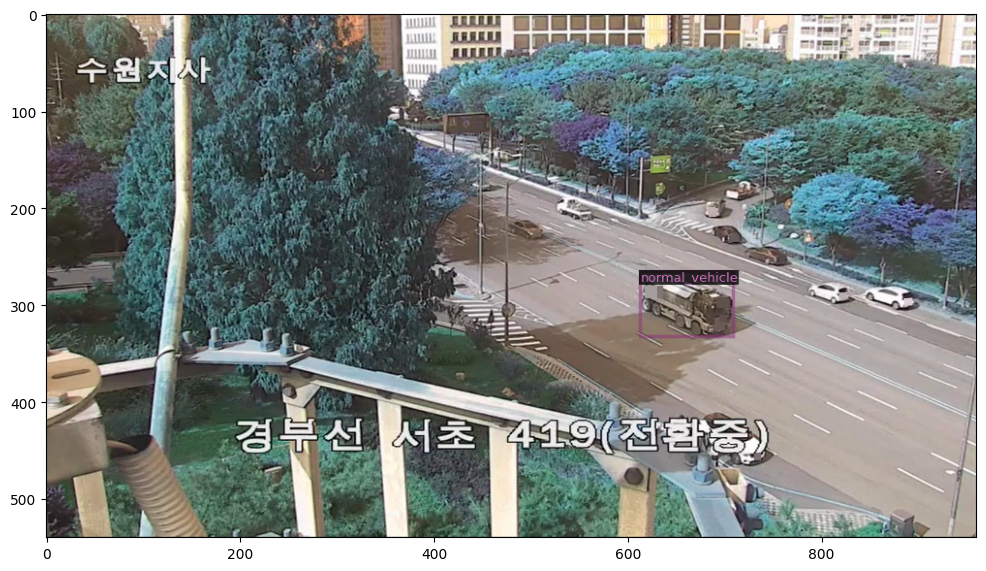

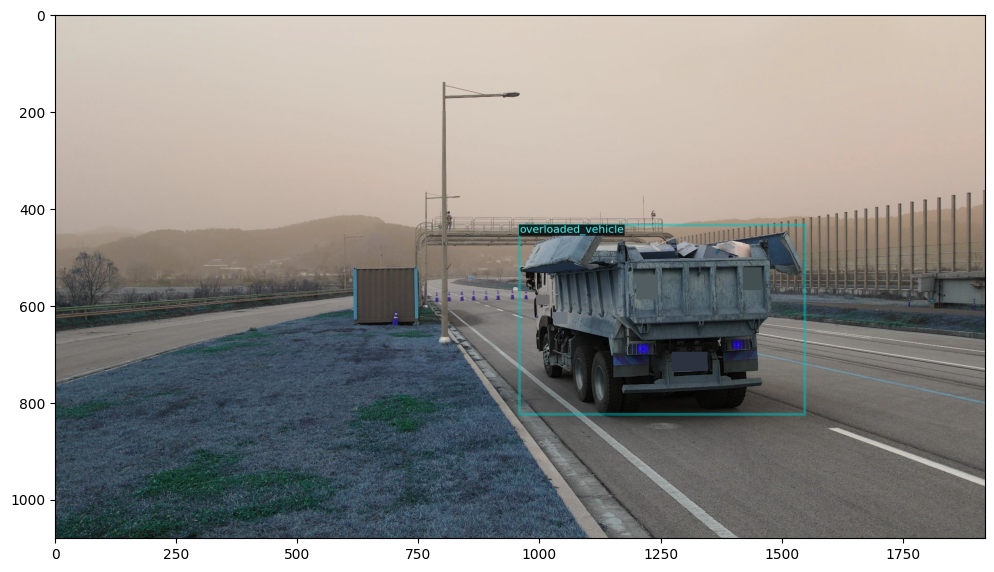

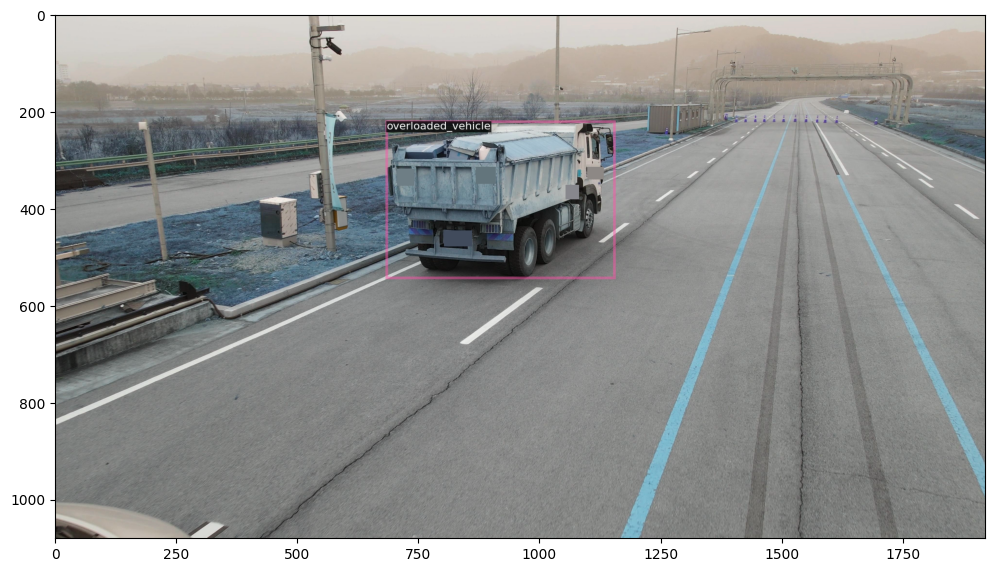

In [4]:
# 파일 경로 설정
training_json = "/content/drive/MyDrive/Data/merged_training_annotations.json"
validation_json = "/content/drive/MyDrive/Data/merged_validation_annotations.json"
image_dir = "/content/drive/MyDrive/Data/"  # 경로 지정 필요

# 데이터셋 등록
register_coco_instances("vehicle_train", {}, training_json, image_dir)
register_coco_instances("vehicle_val", {}, validation_json, image_dir)

# 메타데이터 가져오기
train_metadata = MetadataCatalog.get("vehicle_train")
val_metadata = MetadataCatalog.get("vehicle_val")

print("Train Dataset Metadata:", train_metadata)
print("Validation Dataset Metadata:", val_metadata)

# training 데이터셋 시각화
train_dataset_dicts = DatasetCatalog.get("vehicle_train")
for d in random.sample(train_dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=train_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    plt.figure(figsize=(12, 8))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.show()


#Train the model

In [5]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("vehicle_train",)
cfg.DATASETS.TEST = ("vehicle_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # 사전 학습된 모델 사용
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000  # 학습 반복 횟수 조정
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # 두 가지 클래스: 정상차량과 적재불량 차량

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[06/20 05:43:11 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:00, 192MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[06/20 05:43:12 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/20 05:43:31 d2.utils.events]:  eta: 0:08:52  iter: 19  total_loss: 1.44  loss_cls: 0.9949  loss_box_reg: 0.4037  loss_rpn_cls: 0.02841  loss_rpn_loc: 0.001897    time: 0.6486  last_time: 1.1167  data_time: 0.1914  last_data_time: 0.6329   lr: 4.9953e-06  max_mem: 2549M
[06/20 05:43:47 d2.utils.events]:  eta: 0:08:33  iter: 39  total_loss: 1.347  loss_cls: 0.9122  loss_box_reg: 0.4029  loss_rpn_cls: 0.01898  loss_rpn_loc: 0.001957    time: 0.6436  last_time: 0.4914  data_time: 0.1509  last_data_time: 0.0092   lr: 9.9902e-06  max_mem: 2549M
[06/20 05:43:59 d2.utils.events]:  eta: 0:08:19  iter: 59  total_loss: 1.208  loss_cls: 0.7639  loss_box_reg: 0.4124  loss_rpn_cls: 0.02135  loss_rpn_loc: 0.001727    time: 0.6215  last_time: 0.5059  data_time: 0.0964  last_data_time: 0.0060   lr: 1.4985e-05  max_mem: 2551M
[06/20 05:44:11 d2.utils.events]:  eta: 0:08:14  iter: 79  total_loss: 1.022  loss_cls: 0.5968  loss_box_reg: 0.3777  loss_rpn_cls: 0.01843  loss_rpn_loc: 0.001697    time: 0.6

#Evaluate Model Performance

In [6]:
# 이미지에 대해 추론 수행
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # "적재불량 차량"과 "정상 차량" 두 가지 클래스
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # 학습된 모델 가중치
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # 테스트 시 사용할 confidence threshold

predictor = DefaultPredictor(cfg)

# 이미지에 대해 추론 수행
def perform_inference(folder_path, predictor, metadata):
    if not os.path.isdir(folder_path):
        print(f"Error: Directory {folder_path} does not exist.")
        return

    for filename in os.listdir(folder_path):
        file_path = os.path.join(folder_path, filename)

        if not os.path.isfile(file_path):
            print(f"Warning: {file_path} is not a valid file.")
            continue

        img = cv2.imread(file_path)
        if img is None:
            print(f"Error: Failed to load image {file_path}.")
            continue

        outputs = predictor(img)

# 테스트 이미지 경로 설정
test_image_path = "/content/drive/MyDrive/Data/validation/source"  # 경로 지정 필요
perform_inference(test_image_path, predictor, MetadataCatalog.get("vehicle_train"))

# 평가를 위한 데이터 로더 및 평가자 초기화
evaluator = COCOEvaluator("vehicle_val", output_dir="/content/drive/MyDrive/Data/output")
val_loader = build_detection_test_loader(cfg, "vehicle_val")

# 모델 성능 평가.
evaluation_results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(evaluation_results)


[06/20 05:54:04 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
[06/20 05:54:20 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [06/20 05:54:20 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/20 05:54:20 d2.data.datasets.coco]: Loaded 63 images in COCO format from /content/drive/MyDrive/Data/merged_validation_annotations.json
[06/20 05:54:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/20 05:54:20 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[06/20 05:54:20 d2.data.common]: Serializing 63 elements to byte tensors and concatenating them all ...
[06/20 05:54:20 d2.data.common]: Serialized dataset takes 0.02 MiB
[06/20 05:54:20 d2.eva

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[06/20 05:54:22 d2.evaluation.evaluator]: Inference done 11/63. Dataloading: 0.0052 s/iter. Inference: 0.1238 s/iter. Eval: 0.0004 s/iter. Total: 0.1293 s/iter. ETA=0:00:06
[06/20 05:54:27 d2.evaluation.evaluator]: Inference done 38/63. Dataloading: 0.0467 s/iter. Inference: 0.1318 s/iter. Eval: 0.0007 s/iter. Total: 0.1795 s/iter. ETA=0:00:04
[06/20 05:54:33 d2.evaluation.evaluator]: Inference done 55/63. Dataloading: 0.0838 s/iter. Inference: 0.1385 s/iter. Eval: 0.0007 s/iter. Total: 0.2232 s/iter. ETA=0:00:01
[06/20 05:54:34 d2.evaluation.evaluator]: Total inference time: 0:00:12.251030 (0.211225 s / iter per device, on 1 devices)
[06/20 05:54:34 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:07 (0.135073 s / iter per device, on 1 devices)
[06/20 05:54:34 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[06/20 05:54:34 d2.evaluation.coco_evaluation]: Saving results to /content/drive/MyDrive/Data/output/coco_instances_results.json
[06/20 05:54

# **과적 차량 이미지 구글 드라이브에 저장**

In [7]:
# 함수 정의: 과적차량 탐지 및 저장
def detect_overloaded_vehicles(folder_path, predictor, metadata, output_folder):
    if not os.path.isdir(folder_path):
        print(f"Error: Directory {folder_path} does not exist.")
        return []

    # 구글 드라이브에 폴더 생성
    os.makedirs(output_folder, exist_ok=True)

    detected_files = []

    for file_name in os.listdir(folder_path):
        file_path = os.path.join(folder_path, file_name)

        if os.path.isfile(file_path) and file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
            img = cv2.imread(file_path)
            if img is None:
                print(f"Error: Failed to load image {file_path}.")
                continue

            outputs = predictor(img)

            # Iterate through detected instances
            instances = outputs["instances"]
            for i in range(len(instances)):
                if instances.pred_classes[i] == 1:  # Assuming category_id 1 represents "과적차량"
                    # Save the image as jpg
                    save_path = os.path.join(output_folder, f"{file_name[:-4]}_overloaded.jpg")
                    cv2.imwrite(save_path, img)
                    detected_files.append(save_path)
                    break  # Break after first instance detection (if needed)

        else:
            print(f"Skipping non-image file: {file_path}")

    return detected_files

# 설정 및 모델 로드
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # 두 개의 클래스: 정상 차량, 과적차량
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # 학습된 모델 가중치
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # 신뢰도 임계값 설정

predictor = DefaultPredictor(cfg)

# 테스트 이미지 폴더 경로 설정
test_image_folder_path = "/content/drive/MyDrive/Data/validation/source"  # 수정 필요

# 결과 저장할 폴더 경로 설정 (구글 드라이브 경로)
output_folder = "/content/drive/MyDrive/Data/overloaded_images"  # 수정 필요

# 과적차량 탐지 및 저장
detected_files = detect_overloaded_vehicles(test_image_folder_path, predictor, MetadataCatalog.get("vehicle_train"), output_folder)

# detected_files 리스트에는 과적차량으로 탐지된 이미지들의 파일 경로가 포함됩니다.
print("Detected overloaded vehicle images:")
print(detected_files)

[06/20 05:54:50 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
Detected overloaded vehicle images:
['/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_1_3_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_1_2_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_1_1_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_1_5_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_2_1_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_2_2_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1123_I04_F10_2_3_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1122_I04_F10_7_5_overloaded.jpg', '/content/drive/MyDrive/Data/overloaded_images/A01_B01_C04_D05_1122_

# easy ocr


#result image saving_change JSON to JPG

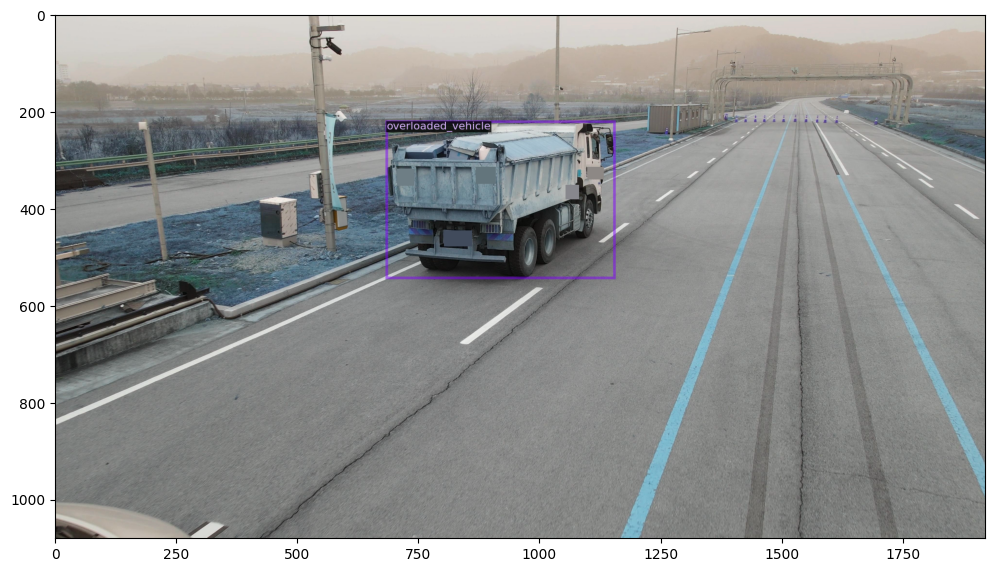

In [8]:
import cv2
from detectron2.utils.visualizer import Visualizer
import matplotlib.pyplot as plt

# 결과 이미지 폴더 경로 설정
result_overload = "/content/drive/MyDrive/Data/output/coco_instances_results.json"  # 폴더 경로 지정

# Assume d is your dataset dictionary containing relevant information
# Load the image using OpenCV
img = cv2.imread(d["file_name"])

# Create a Visualizer instance and draw on the image
visualizer = Visualizer(img[:, :, ::-1], metadata=train_metadata, scale=0.5)
out = visualizer.draw_dataset_dict(d)

# Display the image using Matplotlib
plt.figure(figsize=(12, 8))
plt.imshow(out.get_image()[:, :, ::-1])  # Show the image, converting BGR to RGB

# Save the plotted image as JPG
plt.savefig('/content/drive/MyDrive/Data/output/result.jpg')

# Show the plot
plt.show()


#import easy ocr

In [9]:
#you need to install pytorch in anaconda environment
import os
import locale
import subprocess

# Check if locale is set correctly locale.setlocale(locale.LC_ALL, 'UTF-8')

locale.getpreferredencoding = lambda: "UTF-8"

!pip install transformers==4.28.1

# Install EasyOCR
!pip install easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 65.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 65.5 MB/s eta 0:00:00
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.19.1
    Uninstalling tokenizers-0.19.1:
      Successfully uninstalled tokenizers-0.19.1
  Attempting uninstall: transformers
    Found existing installation: transformers 4.41.2
    Uninstalling transformers-4.41.2:
      Successfully uninstalled transformers-4.41.2


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 39.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 54.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 39.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manyl

In [10]:
import torch.backends.cudnn as cudnn
import yaml
import pandas as pd
import easyocr

# Uncomment if these are defined elsewhere
# from train import train
# from utils import AttrDict

cudnn.benchmark = True
cudnn.deterministic = False

reader = easyocr.Reader(['ko']) # this needs to run only once to load the model into memory

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.1% Complete

#Text extraction

In [11]:
reader.readtext('/content/drive/MyDrive/Data/output/result.jpg', detail=0)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


['200',
 '갈리,기미라찍]디_0]미디이리',
 '400',
 '800',
 '1000',
 '250',
 '500',
 '750',
 '1000',
 '1250',
 '1500',
 '1750']

Processing file: A01_B01_C04_D05_1123_I04_F10_1_3_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_1_3_overloaded.jpg: []


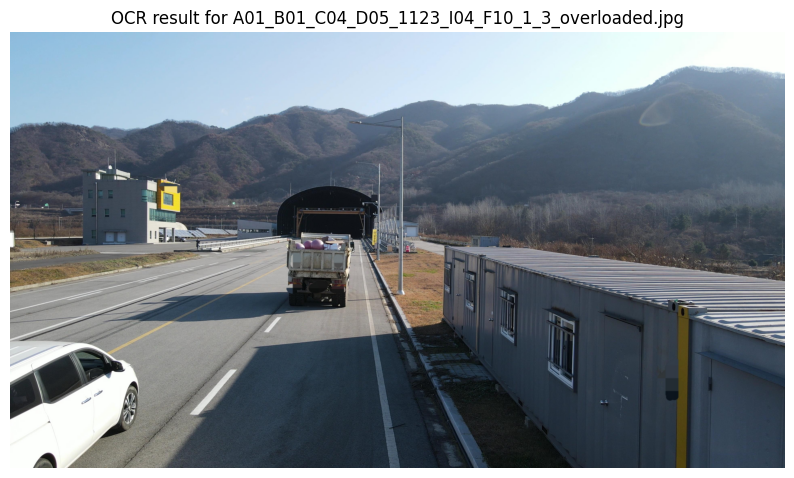

Processing file: A01_B01_C04_D05_1123_I04_F10_1_2_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_1_2_overloaded.jpg: []


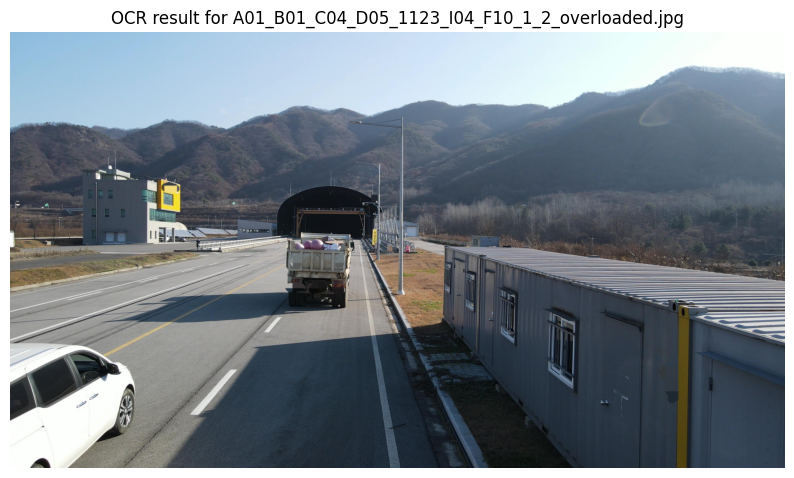

Processing file: A01_B01_C04_D05_1123_I04_F10_1_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_1_1_overloaded.jpg: []


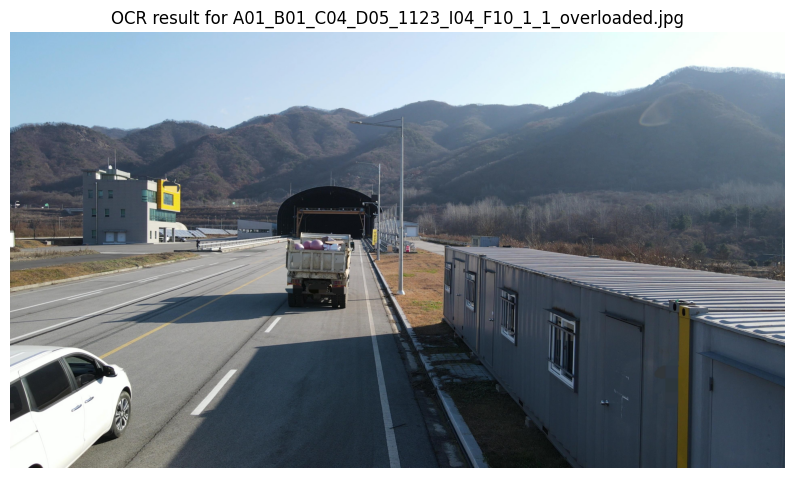

Processing file: A01_B01_C04_D05_1123_I04_F10_1_5_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_1_5_overloaded.jpg: []


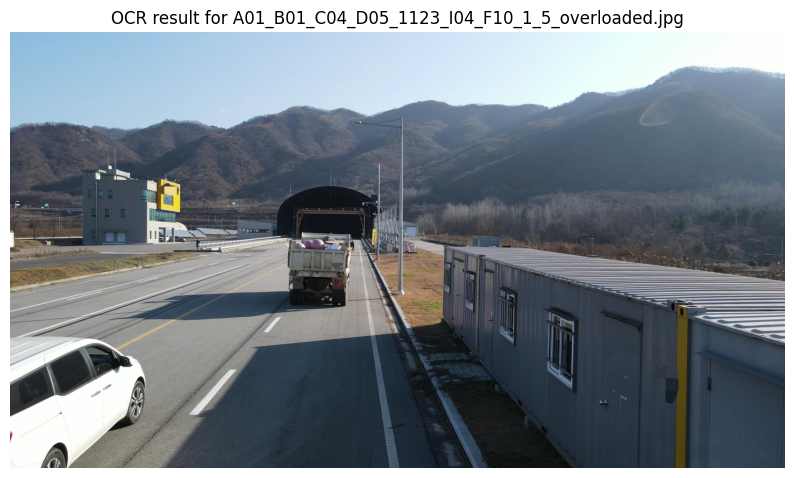

Processing file: A01_B01_C04_D05_1123_I04_F10_2_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_2_1_overloaded.jpg: ['출']


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52636 (\N{HANGUL SYLLABLE CUL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


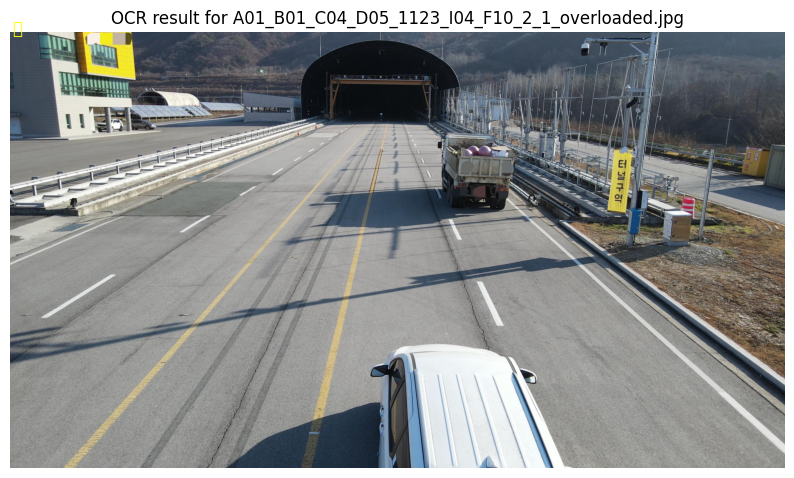

Processing file: A01_B01_C04_D05_1123_I04_F10_2_2_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_2_2_overloaded.jpg: ['출']


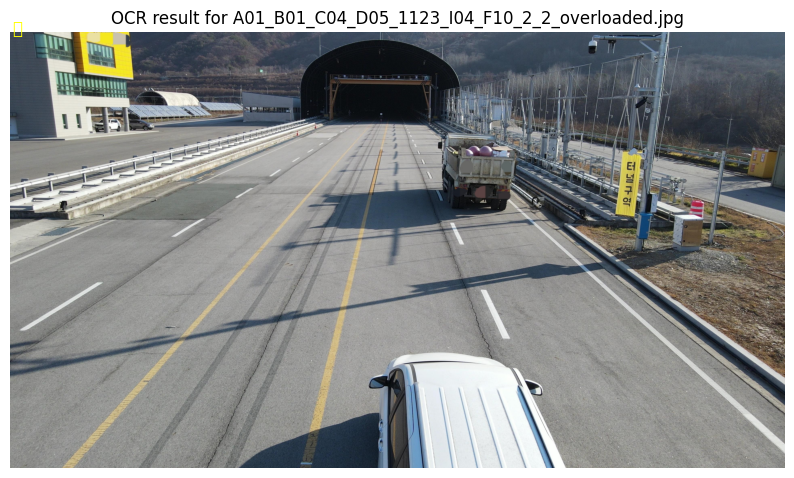

Processing file: A01_B01_C04_D05_1123_I04_F10_2_3_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_2_3_overloaded.jpg: ['탑']


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 53457 (\N{HANGUL SYLLABLE TAB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


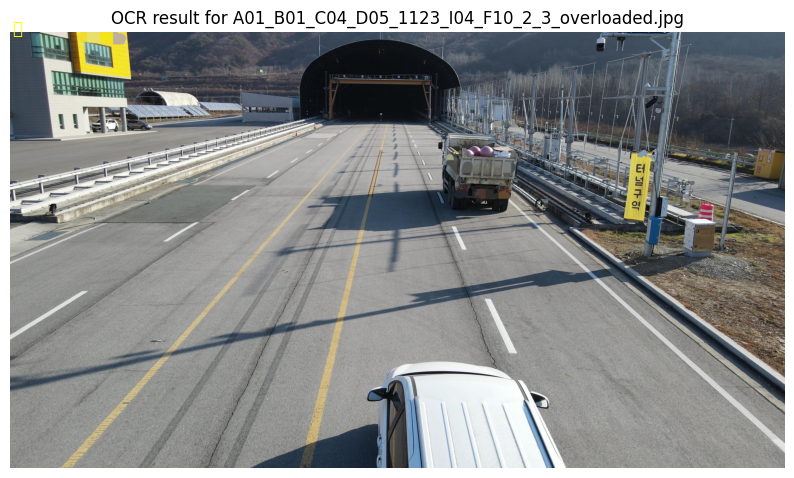

Processing file: A01_B01_C04_D05_1122_I04_F10_7_5_overloaded.jpg
OCR result for A01_B01_C04_D05_1122_I04_F10_7_5_overloaded.jpg: []


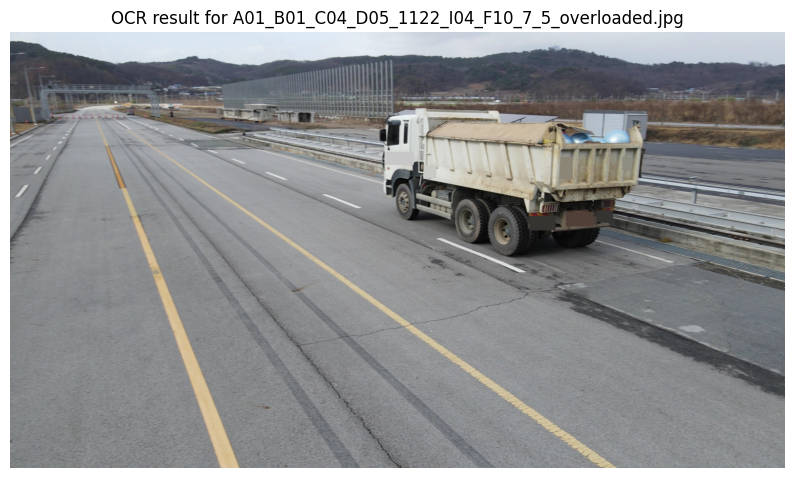

Processing file: A01_B01_C04_D05_1122_I04_F10_7_4_overloaded.jpg
OCR result for A01_B01_C04_D05_1122_I04_F10_7_4_overloaded.jpg: []


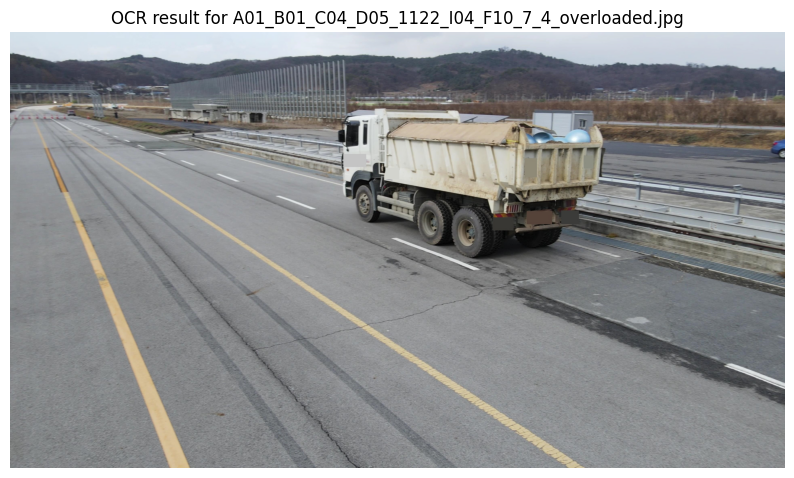

Processing file: A01_B01_C04_D05_1123_I04_F10_949_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_949_1_overloaded.jpg: []


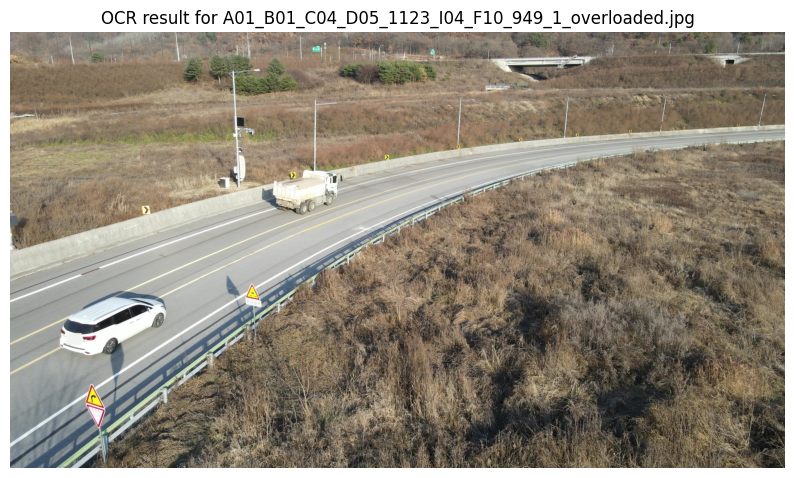

Processing file: A01_B01_C04_D05_1123_I04_F10_863_2_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_863_2_overloaded.jpg: ['=']


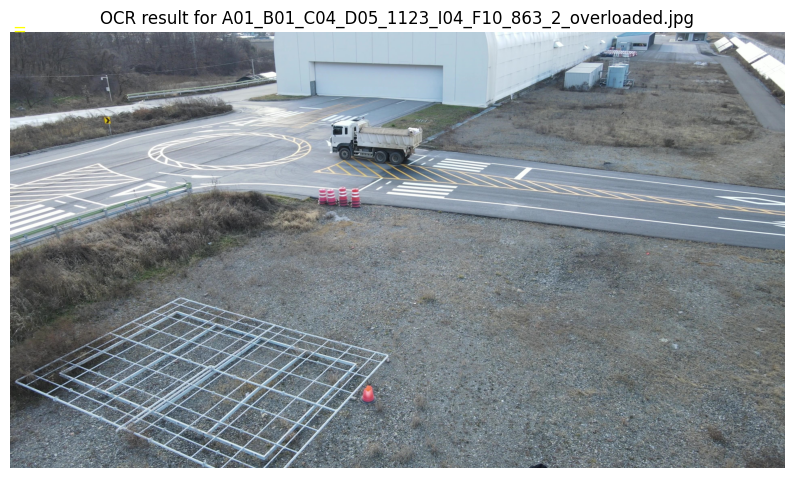

Processing file: A01_B01_C04_D05_1123_I04_F10_841_3_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_841_3_overloaded.jpg: []


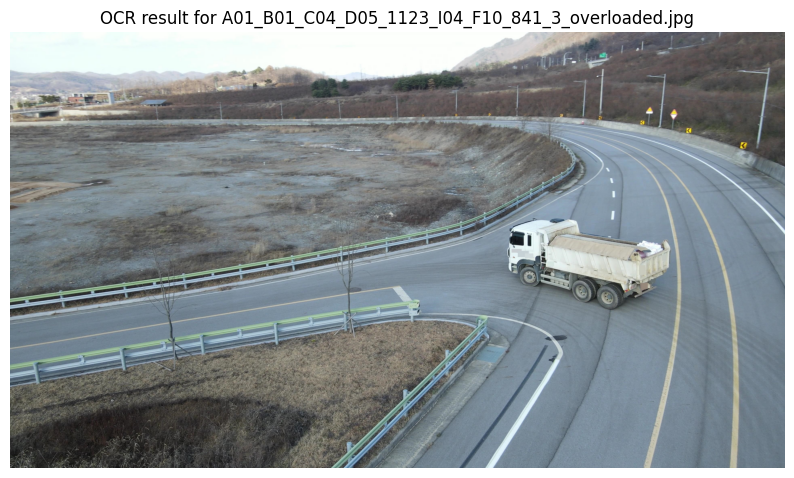

Processing file: A01_B01_C04_D05_1123_I04_F10_841_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_841_1_overloaded.jpg: []


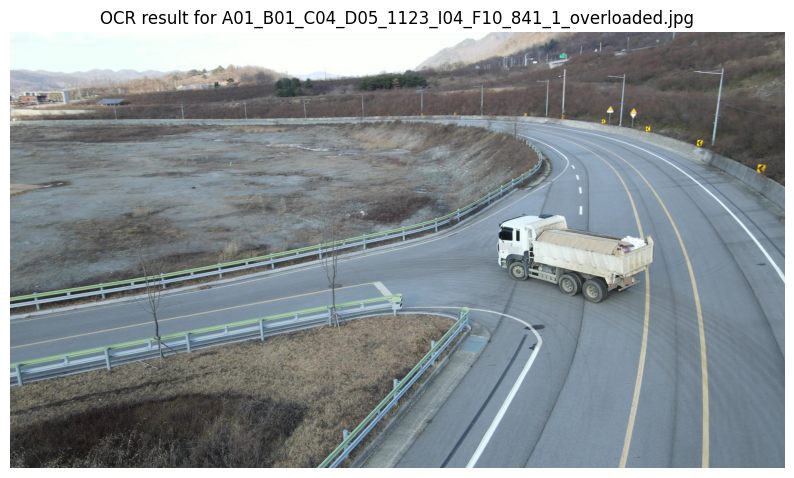

Processing file: A01_B01_C04_D05_1123_I04_F10_952_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_952_1_overloaded.jpg: []


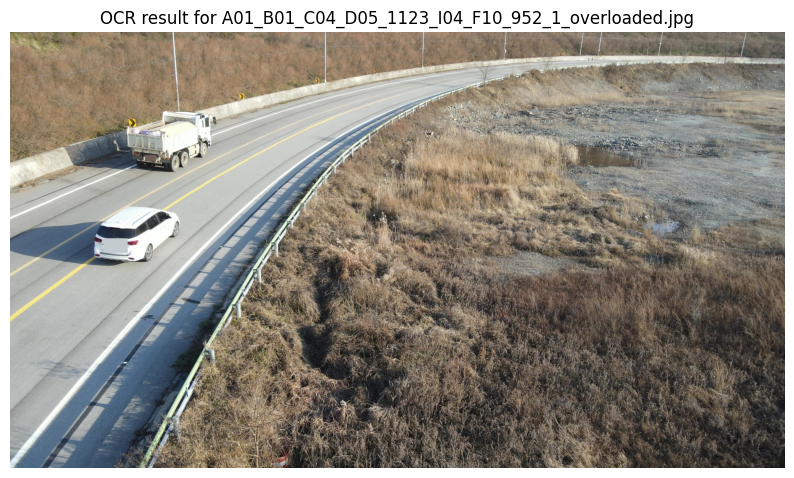

Processing file: A01_B01_C04_D05_1123_I04_F10_850_5_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_850_5_overloaded.jpg: []


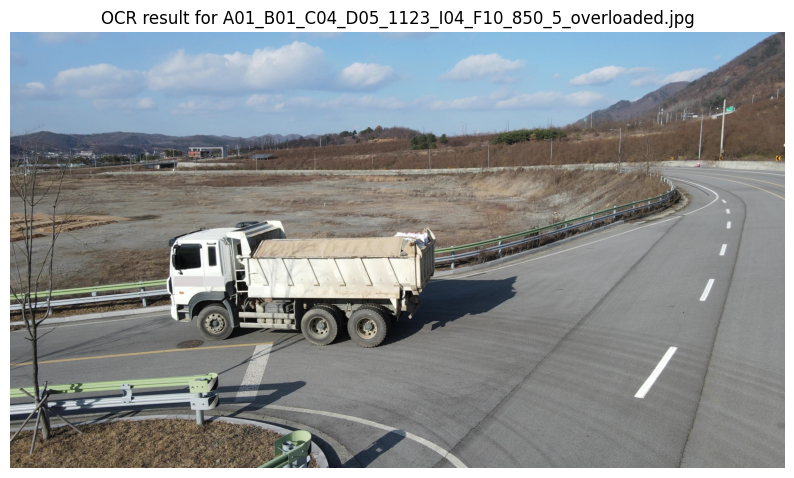

Processing file: A01_B01_C04_D05_1123_I04_F10_859_4_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_859_4_overloaded.jpg: []


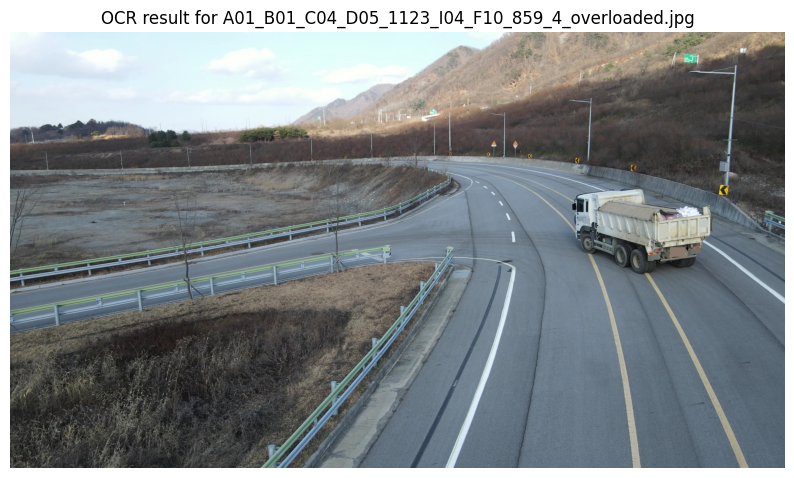

Processing file: A01_B01_C04_D05_1123_I04_F10_948_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_948_1_overloaded.jpg: []


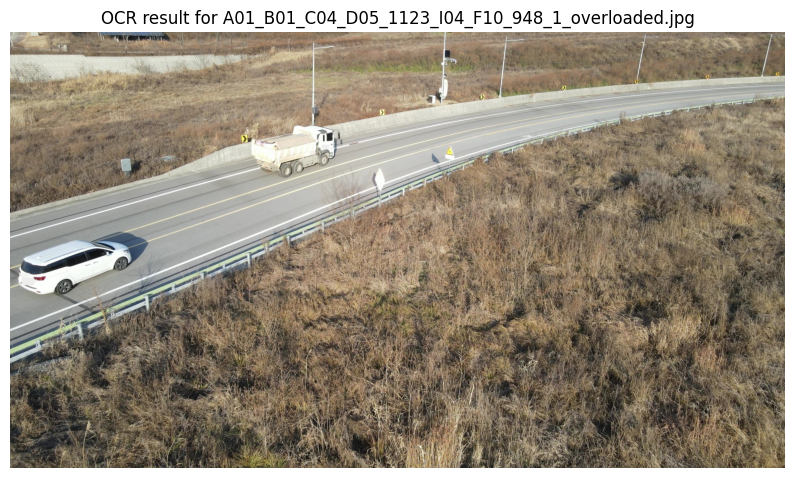

Processing file: A01_B01_C04_D05_1123_I04_F10_855_5_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_855_5_overloaded.jpg: []


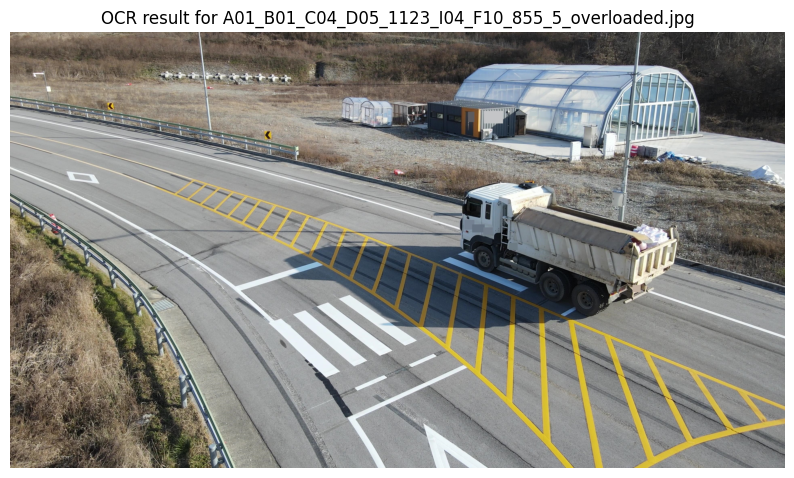

Processing file: A01_B01_C04_D05_1123_I04_F10_951_1_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_951_1_overloaded.jpg: []


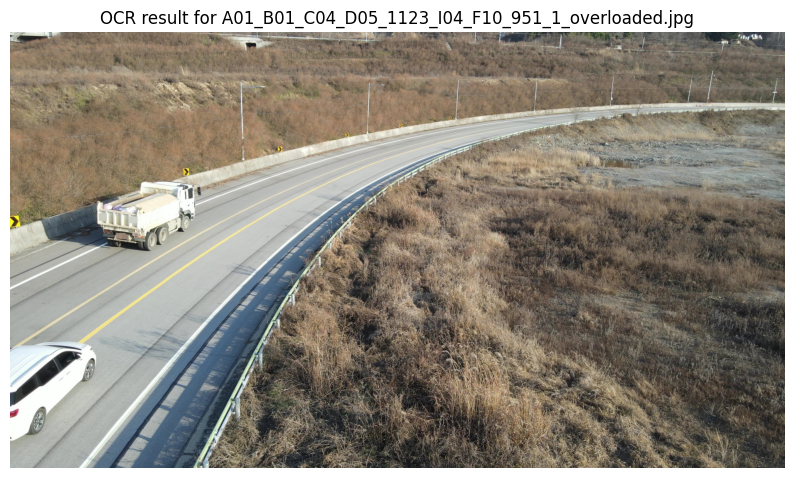

Processing file: A01_B01_C04_D05_1123_I04_F10_866_4_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_866_4_overloaded.jpg: []


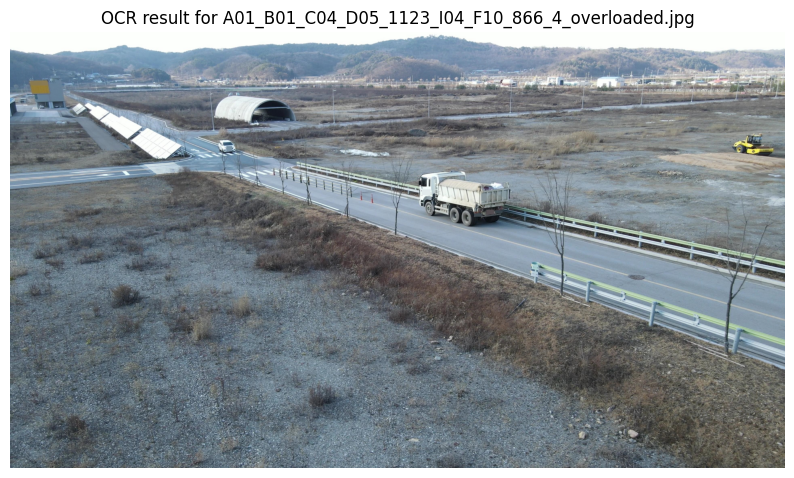

Processing file: A01_B01_C04_D05_1123_I04_F10_866_3_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_866_3_overloaded.jpg: []


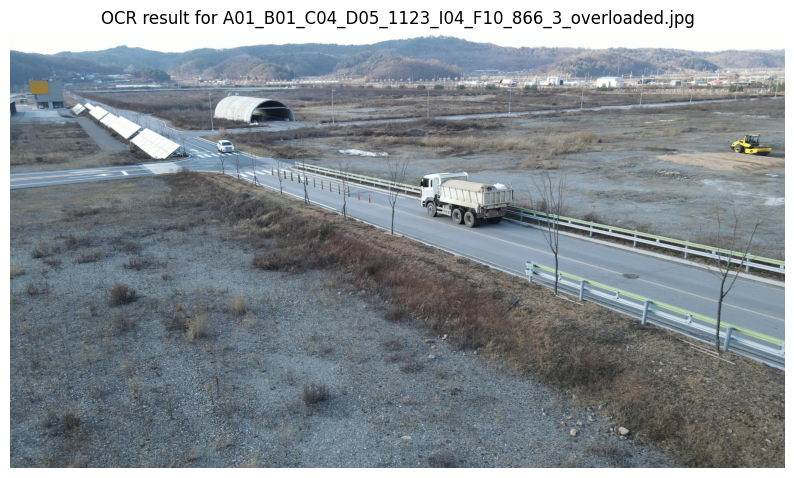

Processing file: A01_B01_C04_D05_1123_I04_F10_866_2_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_866_2_overloaded.jpg: []


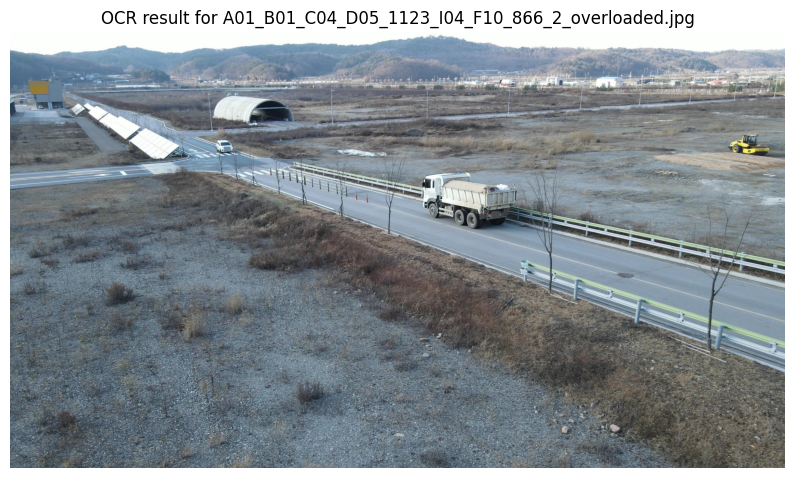

Processing file: A01_B01_C04_D05_1123_I04_F10_862_5_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_862_5_overloaded.jpg: []


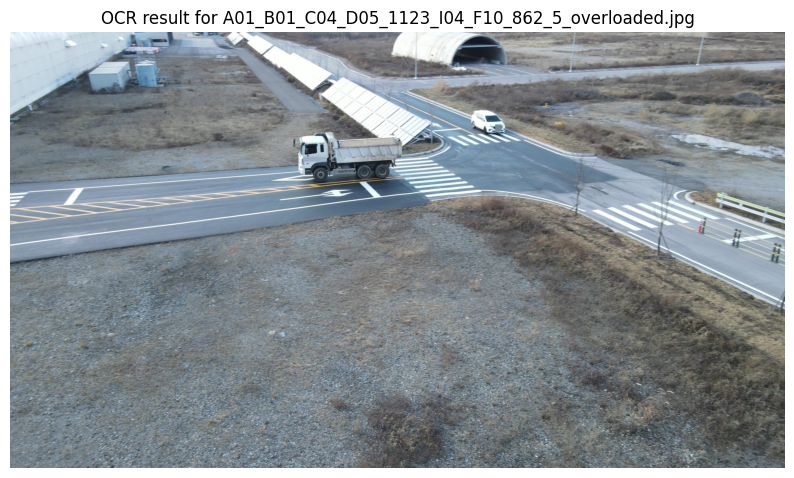

Processing file: A01_B01_C04_D05_1123_I04_F10_857_5_overloaded.jpg
OCR result for A01_B01_C04_D05_1123_I04_F10_857_5_overloaded.jpg: []


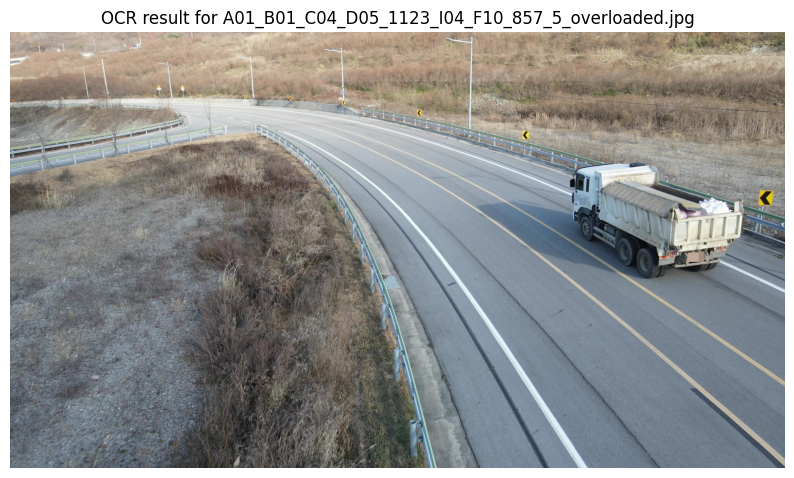

Processing file: do0113_1_overloaded.jpg
OCR result for do0113_1_overloaded.jpg: ['_#도', '25', '다학원']


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 46020 (\N{HANGUL SYLLABLE DO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 45796 (\N{HANGUL SYLLABLE DA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54617 (\N{HANGUL SYLLABLE HAG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50896 (\N{HANGUL SYLLABLE WEON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


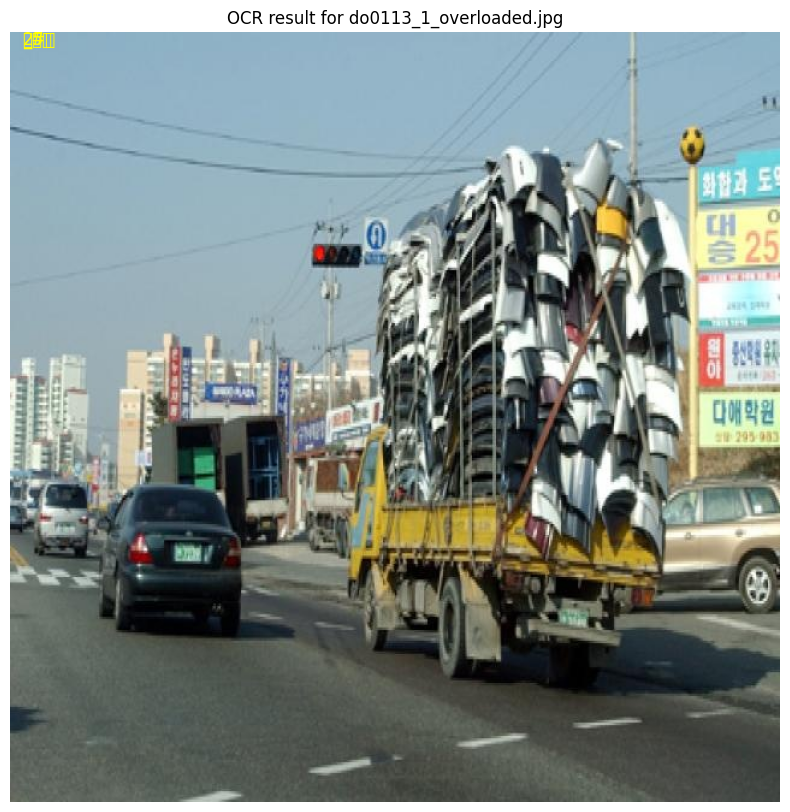

In [12]:
#해당 디렉터리에 저장된 과적차량 이미지들에 대해 텍스트 추출 시행
image_directory = "/content/drive/MyDrive/Data/overloaded_images"

# OCR 결과를 저장할 리스트 초기화
ocr_results = []

# 디렉터리 내의 모든 파일을 순회
for filename in os.listdir(image_directory):
    # 파일의 전체 경로 생성
    file_path = os.path.join(image_directory, filename)

    # 이미지 파일만 처리
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        print(f"Processing file: {filename}")

        # 이미지 읽기
        img = cv2.imread(file_path)
        if img is None:
            print(f"Failed to load image: {file_path}")
            continue

        # OCR 수행
        result = reader.readtext(img, detail=0)
        print(f"OCR result for {filename}: {result}")

        # 결과 저장
        ocr_results.append({
            "filename": filename,
            "text": result
        })

        # 이미지와 OCR 결과 시각화
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"OCR result for {filename}")
        for res in result:
            plt.text(10, 10, str(res), color='yellow', fontsize=12, ha='left')
        plt.show()